In [ ]:
## PUBG FINISH PLACEMENT



# > **PUBG FINISH PLACEMENT PREDICTION**
## **PROBLEM STATEMENT**
![](https://storage.googleapis.com/kaggle-media/competitions/PUBG/PUBG%20Inlay.jpg)
So, where we droppin' boys and girls?

Battle Royale-style video games have taken the world by storm. 100 players are dropped onto an island empty-handed and must explore, scavenge, and eliminate other players until only one is left standing, all while the play zone continues to shrink.

PlayerUnknown's BattleGrounds (PUBG) has enjoyed massive popularity. With over 50 million copies sold, it's the fifth best selling game of all time, and has millions of active monthly players.

The team at PUBG has made official game data available for the public to explore and scavenge outside of "The Blue Circle." This competition is not an official or affiliated PUBG site - Kaggle collected data made possible through the PUBG Developer API.

You are given over 65,000 games' worth of anonymized player data, split into training and testing sets, and asked to predict final placement from final in-game stats and initial player ratings.

What's the best strategy to win in PUBG? Should you sit in one spot and hide your way into victory, or do you need to be the top shot? Let's let the data do the talking!

**Let's first install required libraries.**

In [ ]:
!pip install numpy pandas matplotlib seaborn --quiet

In [ ]:
!pip install jovian opendatasets xgboost graphviz lightgbm scikit-learn xgboost lightgbm --upgrade --quiet

     |████████████████████████████████| 68 kB 4.3 MB/s 
     |████████████████████████████████| 166.7 MB 11 kB/s 
     |████████████████████████████████| 2.0 MB 50.3 MB/s 
     |████████████████████████████████| 22.3 MB 1.2 MB/s 


## **Downloading the Data**

We can download the dataset from Kaggle directly within the Jupyter notebook using the `opendatasets` library. Make sure to [accept the competition rules](https://www.kaggle.com/c/pubg-finish-placement-prediction/rules) before executing the following cell.

In [ ]:
import os
import opendatasets as od
import pandas as pd
pd.set_option("display.max_columns", 120)
pd.set_option("display.max_rows", 120)

In [ ]:
od.download('https://www.kaggle.com/c/pubg-finish-placement-prediction')

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: shouryaanant
Your Kaggle Key: ··········


100%|██████████| 361M/361M [00:02<00:00, 136MB/s]



Extracting archive ./pubg-finish-placement-prediction/pubg-finish-placement-prediction.zip to ./pubg-finish-placement-prediction


In [ ]:
os.listdir('pubg-finish-placement-prediction')

['sample_submission_V2.csv', 'train_V2.csv', 'test_V2.csv']

Let's load the data into Pandas dataframes.

In [ ]:
pubg_df = pd.read_csv('./pubg-finish-placement-prediction/train_V2.csv', low_memory=False)
test_df = pd.read_csv('./pubg-finish-placement-prediction/test_V2.csv')
submission_df = pd.read_csv('./pubg-finish-placement-prediction/sample_submission_V2.csv')

In [ ]:
pubg_df

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,longestKill,matchDuration,matchType,maxPlace,numGroups,rankPoints,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc
0,7f96b2f878858a,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,60,1241,0,0,0.00,1306,squad-fpp,28,26,-1,0,0.0000,0,0.000,0,0,244.80,1,1466,0.4444
1,eef90569b9d03c,684d5656442f9e,aeb375fc57110c,0,0,91.47,0,0,0,57,0,0,0,0.00,1777,squad-fpp,26,25,1484,0,0.0045,0,11.040,0,0,1434.00,5,0,0.6400
2,1eaf90ac73de72,6a4a42c3245a74,110163d8bb94ae,1,0,68.00,0,0,0,47,0,0,0,0.00,1318,duo,50,47,1491,0,0.0000,0,0.000,0,0,161.80,2,0,0.7755
3,4616d365dd2853,a930a9c79cd721,f1f1f4ef412d7e,0,0,32.90,0,0,0,75,0,0,0,0.00,1436,squad-fpp,31,30,1408,0,0.0000,0,0.000,0,0,202.70,3,0,0.1667
4,315c96c26c9aac,de04010b3458dd,6dc8ff871e21e6,0,0,100.00,0,0,0,45,0,1,1,58.53,1424,solo-fpp,97,95,1560,0,0.0000,0,0.000,0,0,49.75,2,0,0.1875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4446961,afff7f652dbc10,d238e426f50de7,18492834ce5635,0,0,0.00,0,0,0,74,1029,0,0,0.00,1873,squad-fpp,29,28,-1,0,1292.0000,0,0.000,0,0,1019.00,3,1507,0.1786
4446962,f4197cf374e6c0,408cdb5c46b2ac,ee854b837376d9,0,1,44.15,0,0,0,69,0,0,0,0.00,1435,solo,93,93,1501,0,0.0000,0,0.000,0,0,81.70,6,0,0.2935
4446963,e1948b1295c88a,e26ac84bdf7cef,6d0cd12784f1ab,0,0,59.06,0,0,0,66,0,0,0,0.00,1321,squad-fpp,28,28,1500,0,0.0000,0,2.184,0,0,788.70,4,0,0.4815
4446964,cc032cdd73b7ac,c2223f35411394,c9c701d0ad758a,0,4,180.40,1,1,2,11,0,2,1,98.50,1373,squad-fpp,26,25,1418,2,0.0000,0,0.000,0,0,2748.00,8,0,0.8000


In [ ]:
test_df

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,longestKill,matchDuration,matchType,maxPlace,numGroups,rankPoints,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints
0,9329eb41e215eb,676b23c24e70d6,45b576ab7daa7f,0,0,51.46,0,0,0,73,0,0,0,0.00,1884,squad-fpp,28,28,1500,0,0.0,0,0.000,0,0,588.00,1,0
1,639bd0dcd7bda8,430933124148dd,42a9a0b906c928,0,4,179.10,0,0,2,11,0,2,1,361.90,1811,duo-fpp,48,47,1503,2,4669.0,0,0.000,0,0,2017.00,6,0
2,63d5c8ef8dfe91,0b45f5db20ba99,87e7e4477a048e,1,0,23.40,0,0,4,49,0,0,0,0.00,1793,squad-fpp,28,27,1565,0,0.0,0,0.000,0,0,787.80,4,0
3,cf5b81422591d1,b7497dbdc77f4a,1b9a94f1af67f1,0,0,65.52,0,0,0,54,0,0,0,0.00,1834,duo-fpp,45,44,1465,0,0.0,0,0.000,0,0,1812.00,3,0
4,ee6a295187ba21,6604ce20a1d230,40754a93016066,0,4,330.20,1,2,1,7,0,3,1,60.06,1326,squad-fpp,28,27,1480,1,0.0,0,0.000,0,0,2963.00,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1934169,a316c3a13887d5,80e82180c90951,f276da5fd73536,1,2,381.00,3,0,7,4,1294,4,2,69.27,1292,squad-fpp,22,20,-1,1,0.0,0,0.000,0,0,1799.00,5,1526
1934170,5312146b27d875,147264a127c56e,fb77cbfe094a6b,0,0,0.00,0,0,0,64,1449,0,0,0.00,1301,squad-fpp,27,26,-1,0,0.0,0,0.000,0,0,1195.00,3,1496
1934171,fc8818b5b32ad3,7bbb4779ebedd5,efb74d5f6e9779,0,0,91.96,0,0,3,24,0,1,1,25.38,1314,squad-fpp,29,29,1482,0,0.0,0,7.798,1,0,3327.00,3,0
1934172,a0f91e35f8458f,149a506a64c2b1,3a2cf335bc302f,1,2,138.60,0,0,12,25,0,1,1,67.89,1333,duo-fpp,49,48,1456,1,0.0,0,0.000,0,0,1893.00,4,0


In [ ]:
submission_df

,Id,winPlacePerc
0,9329eb41e215eb,1
1,639bd0dcd7bda8,1
2,63d5c8ef8dfe91,1
3,cf5b81422591d1,1
4,ee6a295187ba21,1
...,...,...
1934169,a316c3a13887d5,1
1934170,5312146b27d875,1
1934171,fc8818b5b32ad3,1
1934172,a0f91e35f8458f,1


## Preprocessing and Feature Engineering

Let's take a look at the available columns, and figure out if we can create new columns or apply any useful transformations.

In [ ]:
pubg_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4446966 entries, 0 to 4446965
Data columns (total 29 columns):
 #   Column           Dtype  
---  ------           -----  
 0   Id               object 
 1   groupId          object 
 2   matchId          object 
 3   assists          int64  
 4   boosts           int64  
 5   damageDealt      float64
 6   DBNOs            int64  
 7   headshotKills    int64  
 8   heals            int64  
 9   killPlace        int64  
 10  killPoints       int64  
 11  kills            int64  
 12  killStreaks      int64  
 13  longestKill      float64
 14  matchDuration    int64  
 15  matchType        object 
 16  maxPlace         int64  
 17  numGroups        int64  
 18  rankPoints       int64  
 19  revives          int64  
 20  rideDistance     float64
 21  roadKills        int64  
 22  swimDistance     float64
 23  teamKills        int64  
 24  vehicleDestroys  int64  
 25  walkDistance     float64
 26  weaponsAcquired  int64  
 27  winPoints   

In [ ]:
pubg_df.isna().sum()

Id                 0
groupId            0
matchId            0
assists            0
boosts             0
damageDealt        0
DBNOs              0
headshotKills      0
heals              0
killPlace          0
killPoints         0
kills              0
killStreaks        0
longestKill        0
matchDuration      0
matchType          0
maxPlace           0
numGroups          0
rankPoints         0
revives            0
rideDistance       0
roadKills          0
swimDistance       0
teamKills          0
vehicleDestroys    0
walkDistance       0
weaponsAcquired    0
winPoints          0
winPlacePerc       1
dtype: int64

Since there is an empty/Nan value in "winPlacePrec" column, it would be good just to drop them as it might be very insignificant as compared to the large dataset.

In [ ]:
pubg_df.dropna(subset=['winPlacePerc'],inplace =True)

In [ ]:
pubg_df.nunique()

Id                 4446965
groupId            2026744
matchId              47964
assists                 20
boosts                  27
damageDealt          29916
DBNOs                   39
headshotKills           34
heals                   63
killPlace              101
killPoints            1707
kills                   58
killStreaks             18
longestKill          28284
matchDuration         1266
matchType               16
maxPlace                99
numGroups              100
rankPoints            2262
revives                 25
rideDistance         33562
roadKills               14
swimDistance         28345
teamKills               11
vehicleDestroys          6
walkDistance         38599
weaponsAcquired         97
winPoints             1447
winPlacePerc          3000
dtype: int64

##  Exploratory Data Analysis and Visualization


 Let's explore and visualize the data using the Plotly, Matplotlib and Seaborn libraries. 

In [ ]:
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [ ]:
px.scatter(pubg_df.sample(1000), x = 'winPlacePerc', title = 'Win Prediction vs kills', y = 'kills')

In [ ]:
fig=px.histogram(pubg_df,
             x='longestKill',
             nbins=50)
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
px.scatter(pubg_df.sample(500),title='killstreaks vs Position prediction',x= 'killStreaks',y='winPlacePerc')

In [ ]:
px.violin(pubg_df.sample(500),title='killstreaks vs Position prediction',x= 'killStreaks',y='winPlacePerc')

In [ ]:
fig1=px.histogram(pubg_df, x= 'headshotKills',color_discrete_sequence=['red'],title='Headshots')
fig1.update_layout(bargap=0.1)
fig1.show()

In [ ]:
px.scatter( pubg_df.sample(1000),x='matchDuration' , y = 'winPlacePerc',color='matchType',title='MatchDuration vs Position' )

In [ ]:
px.scatter( pubg_df.sample(1000),x='damageDealt' , y = 'DBNOs' )

In [ ]:
px.histogram(pubg_df.sample(2000), marginal='box', x= 'DBNOs', color='matchType',title='Number of knockouts')

In [ ]:
px.scatter( pubg_df.sample(1000),x='winPlacePerc' , y = 'DBNOs' )

## Correlation

In [ ]:
pubg_df.winPlacePerc.corr(pubg_df.DBNOs)

0.27996969241749137

In [ ]:
pubg_df.winPlacePerc.corr(pubg_df.rideDistance)

0.34291452824687885

In [ ]:
pubg_df.winPlacePerc.corr(pubg_df.killStreaks)

0.3775664596072869

## **Use of Sample from the dataset**
Since this data is so huge and due to limited resources, I have taken a sample of 100,000.

In [ ]:
sample_df=pubg_df.sample(n=100000,random_state=42)

# **Train, Validation and Test set**

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
train_df, val_df = train_test_split(sample_df, test_size=0.2, random_state=42)

In [ ]:
input_cols= list(pubg_df.columns)[3:-1]
target_cols= 'winPlacePerc'

In [ ]:
input_cols

['assists',
 'boosts',
 'damageDealt',
 'DBNOs',
 'headshotKills',
 'heals',
 'killPlace',
 'killPoints',
 'kills',
 'killStreaks',
 'longestKill',
 'matchDuration',
 'matchType',
 'maxPlace',
 'numGroups',
 'rankPoints',
 'revives',
 'rideDistance',
 'roadKills',
 'swimDistance',
 'teamKills',
 'vehicleDestroys',
 'walkDistance',
 'weaponsAcquired',
 'winPoints']

In [ ]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_cols].copy()
val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_cols].copy()

In [ ]:
test_inputs = test_df[input_cols].copy()

In [ ]:
import numpy as np
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [ ]:
numeric_cols


['assists',
 'boosts',
 'damageDealt',
 'DBNOs',
 'headshotKills',
 'heals',
 'killPlace',
 'killPoints',
 'kills',
 'killStreaks',
 'longestKill',
 'matchDuration',
 'maxPlace',
 'numGroups',
 'rankPoints',
 'revives',
 'rideDistance',
 'roadKills',
 'swimDistance',
 'teamKills',
 'vehicleDestroys',
 'walkDistance',
 'weaponsAcquired',
 'winPoints']

In [ ]:
train_inputs[categorical_cols].nunique()

matchType    16
dtype: int64

In [ ]:
sample_df[numeric_cols].describe()

,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,longestKill,matchDuration,maxPlace,numGroups,rankPoints,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.230670,1.100290,129.365801,0.651270,0.226140,1.369080,47.729750,503.696210,0.911810,0.539670,22.759778,1580.444440,44.537210,43.03397,893.233960,0.163410,608.379891,0.003250,4.631814,0.023570,0.008170,1152.663889,3.666960,605.155150
std,0.583425,1.711216,167.599337,1.130818,0.597431,2.714869,27.354745,626.808686,1.532245,0.709599,50.736464,258.783838,23.852904,23.31115,736.562873,0.463669,1500.026698,0.070424,33.591222,0.164908,0.093933,1188.824945,2.470689,739.234835
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,209.000000,2.000000,1.00000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24.000000,0.000000,0.000000,0.000000,0.000000,1367.000000,28.000000,27.00000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,156.000000,2.000000,0.000000
50%,0.000000,0.000000,83.245000,0.000000,0.000000,0.000000,48.000000,0.000000,0.000000,0.000000,0.000000,1439.000000,30.000000,30.00000,1444.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,677.250000,3.000000,0.000000
75%,0.000000,2.000000,184.100000,1.000000,0.000000,2.000000,71.000000,1169.000000,1.000000,1.000000,20.860000,1852.000000,49.000000,47.00000,1500.000000,0.000000,1.138250,0.000000,0.000000,0.000000,0.000000,1974.000000,5.000000,1495.000000
max,11.000000,17.000000,2852.000000,21.000000,21.000000,48.000000,100.000000,2087.000000,28.000000,10.000000,939.300000,2226.000000,100.000000,100.00000,5725.000000,10.000000,31500.000000,8.000000,3823.000000,3.000000,3.000000,11450.000000,81.000000,1956.000000


## Scaling Numeric Features



In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler = MinMaxScaler()

In [ ]:
scaler.fit(pubg_df[numeric_cols])

MinMaxScaler()

In [ ]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [ ]:
train_inputs[numeric_cols].describe()

,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,longestKill,matchDuration,maxPlace,numGroups,rankPoints,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints
count,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000
mean,0.010453,0.033356,0.019562,0.012297,0.003544,0.017103,0.467142,0.232599,0.012674,0.027025,0.020734,0.687970,0.433626,0.424145,0.151141,0.004200,0.014904,0.000182,0.001207,0.001964,0.001650,0.044587,0.015533,0.301093
std,0.026390,0.051928,0.025289,0.021291,0.009358,0.033821,0.273824,0.289092,0.021242,0.035463,0.046111,0.122941,0.243129,0.235259,0.124644,0.011903,0.036817,0.003983,0.008755,0.013790,0.018928,0.046036,0.010470,0.367347
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.036122,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.230000,0.000000,0.000000,0.000000,0.000000,0.586502,0.265306,0.262626,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.006012,0.008475,0.000000
50%,0.000000,0.000000,0.012607,0.000000,0.000000,0.000000,0.470000,0.000000,0.000000,0.000000,0.000000,0.620722,0.285714,0.292929,0.244459,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.026001,0.012712,0.000000
75%,0.000000,0.060606,0.027842,0.018868,0.000000,0.025000,0.700000,0.539171,0.013889,0.050000,0.019086,0.817015,0.479592,0.464646,0.253933,0.000000,0.000005,0.000000,0.000000,0.000000,0.000000,0.076338,0.021186,0.742673
max,0.409091,0.484848,0.431076,0.358491,0.328125,0.600000,0.990000,0.961751,0.388889,0.500000,0.858592,0.994772,1.000000,1.000000,0.968702,0.256410,0.773766,0.444444,1.000000,0.250000,0.600000,0.444143,0.343220,0.971684


# **Encoding Categorical Data**

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
encoder = OneHotEncoder(sparse=False, handle_unknown= 'ignore')

In [ ]:
encoder.fit(pubg_df[categorical_cols])

OneHotEncoder(handle_unknown='ignore', sparse=False)

In [ ]:
encoder.categories_

[array(['crashfpp', 'crashtpp', 'duo', 'duo-fpp', 'flarefpp', 'flaretpp',
        'normal-duo', 'normal-duo-fpp', 'normal-solo', 'normal-solo-fpp',
        'normal-squad', 'normal-squad-fpp', 'solo', 'solo-fpp', 'squad',
        'squad-fpp'], dtype=object)]

In [ ]:
encoded_cols = list(encoder.get_feature_names(categorical_cols))

In [ ]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

In [ ]:
train_inputs

,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,longestKill,matchDuration,matchType,maxPlace,numGroups,rankPoints,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,matchType_crashfpp,matchType_crashtpp,matchType_duo,matchType_duo-fpp,matchType_flarefpp,matchType_flaretpp,matchType_normal-duo,matchType_normal-duo-fpp,matchType_normal-solo,matchType_normal-solo-fpp,matchType_normal-squad,matchType_normal-squad-fpp,matchType_solo,matchType_solo-fpp,matchType_squad,matchType_squad-fpp
1910367,0.045455,0.060606,0.008464,0.0,0.0,0.0250,0.20,0.000000,0.013889,0.05,0.006151,0.577471,squad-fpp,0.234694,0.242424,0.250550,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.128782,0.021186,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
301592,0.000000,0.030303,0.027993,0.0,0.0,0.0500,0.39,0.000000,0.000000,0.00,0.000000,0.569867,solo,0.928571,0.888889,0.286077,0.000000,0.000000,0.0,0.030918,0.0,0.0,0.062219,0.025424,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4091021,0.000000,0.030303,0.000137,0.0,0.0,0.0000,0.52,0.501843,0.000000,0.00,0.000000,0.833650,duo-fpp,0.469388,0.434343,0.000000,0.000000,0.075829,0.0,0.000000,0.0,0.0,0.064779,0.021186,0.770492,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
185732,0.000000,0.030303,0.000000,0.0,0.0,0.0000,0.72,0.460829,0.000000,0.00,0.000000,0.810361,duo-fpp,0.489796,0.484848,0.000000,0.025641,0.000000,0.0,0.000000,0.0,0.0,0.014744,0.008475,0.745156,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1448511,0.000000,0.000000,0.000000,0.0,0.0,0.0000,0.88,0.601382,0.000000,0.00,0.000000,0.596008,squad-fpp,0.285714,0.272727,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.003585,0.016949,0.739195,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4182466,0.000000,0.030303,0.023836,0.0,0.0,0.0375,0.27,0.450691,0.013889,0.05,0.001597,0.765209,solo-fpp,0.989796,0.959596,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.085687,0.021186,0.732737,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2201289,0.000000,0.030303,0.000000,0.0,0.0,0.0000,0.81,0.670046,0.000000,0.00,0.000000,0.792300,squad-fpp,0.265306,0.272727,0.000169,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.005209,0.008475,0.747144,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1733401,0.000000,0.090909,0.004217,0.0,0.0,0.0375,0.47,0.493548,0.000000,0.00,0.000000,0.806084,squad,0.285714,0.292929,0.000000,0.000000,0.014183,0.0,0.009888,0.0,0.0,0.190846,0.025424,0.708892,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
569461,0.000000,0.030303,0.000000,0.0,0.0,0.0625,0.71,0.000000,0.000000,0.00,0.000000,0.589829,squad-fpp,0.255102,0.262626,0.256809,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.019325,0.012712,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


# **USE OF DIFFERENT ML MODELS:-**


1.   RANDOM FOREST
2.   GRADIENT BOOSTING MACHINE



## **1.RANDOM FOREST**

A random forest works by averaging/combining the results of several decision trees:

<img src="https://1.bp.blogspot.com/-Ax59WK4DE8w/YK6o9bt_9jI/AAAAAAAAEQA/9KbBf9cdL6kOFkJnU39aUn4m8ydThPenwCLcBGAsYHQ/s0/Random%2BForest%2B03.gif" width="640">


We'll use the `RandomForestClassifier` class from `sklearn.ensemble`.

In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
model1 = RandomForestRegressor(n_jobs= -1, random_state= 42)

In [ ]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [ ]:
model1.fit(X_train,train_targets)

RandomForestRegressor(n_jobs=-1, random_state=42)

In [ ]:
model1.score(X_val,val_targets)

0.9164190809163845

In [ ]:
model1.score(X_train,train_targets)

0.9879932484241635

In [ ]:
default_train_score, default_val_score = model1.score(X_train,train_targets) , model1.score(X_val, val_targets)

In [ ]:
def d_error():
  print("score without tuning of hyperparameters for -> \ntraining set: ",default_train_score,"\nvalidation set: ",default_val_score)

### **Visualization**

We can visualize the decision tree _learned_ from the training data.

In [ ]:
from sklearn.tree import plot_tree, export_text
!pip install graphviz --upgrade --quiet

In [ ]:
model_text = export_text(model1.estimators_[0], feature_names=list(X_train.columns))
print(model_text[:3000])

|--- walkDistance <= 0.03
|   |--- killPlace <= 0.74
|   |   |--- walkDistance <= 0.01
|   |   |   |--- killStreaks <= 0.03
|   |   |   |   |--- killPlace <= 0.61
|   |   |   |   |   |--- numGroups <= 0.22
|   |   |   |   |   |   |--- killPlace <= 0.01
|   |   |   |   |   |   |   |--- damageDealt <= 0.01
|   |   |   |   |   |   |   |   |--- weaponsAcquired <= 0.01
|   |   |   |   |   |   |   |   |   |--- value: [0.00]
|   |   |   |   |   |   |   |   |--- weaponsAcquired >  0.01
|   |   |   |   |   |   |   |   |   |--- damageDealt <= 0.00
|   |   |   |   |   |   |   |   |   |   |--- value: [1.00]
|   |   |   |   |   |   |   |   |   |--- damageDealt >  0.00
|   |   |   |   |   |   |   |   |   |   |--- value: [0.00]
|   |   |   |   |   |   |   |--- damageDealt >  0.01
|   |   |   |   |   |   |   |   |--- value: [1.00]
|   |   |   |   |   |   |--- killPlace >  0.01
|   |   |   |   |   |   |   |--- matchType_normal-squad-fpp <= 0.50
|   |   |   |   |   |   |   |   |--- damageDealt <= 0.05
|

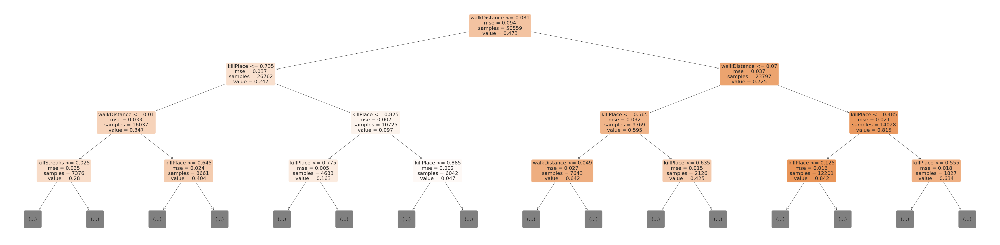

In [ ]:
plt.figure(figsize=(80,20))
plot_tree(model1.estimators_[0], feature_names=X_train.columns, max_depth=3, filled=True, rounded=True, class_names=model1.class_weight);

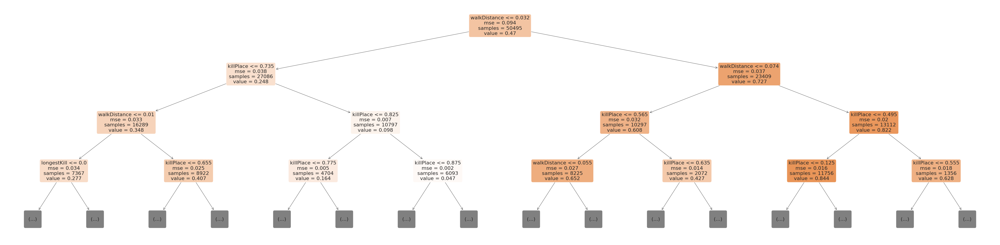

In [ ]:
plt.figure(figsize=(80,20))
plot_tree(model1.estimators_[99], feature_names=X_train.columns, max_depth=3, filled=True, rounded=True, class_names=model1.class_weight);

In [ ]:
len(model1.estimators_)

100

In [ ]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model1.feature_importances_
}).sort_values('importance', ascending=False)

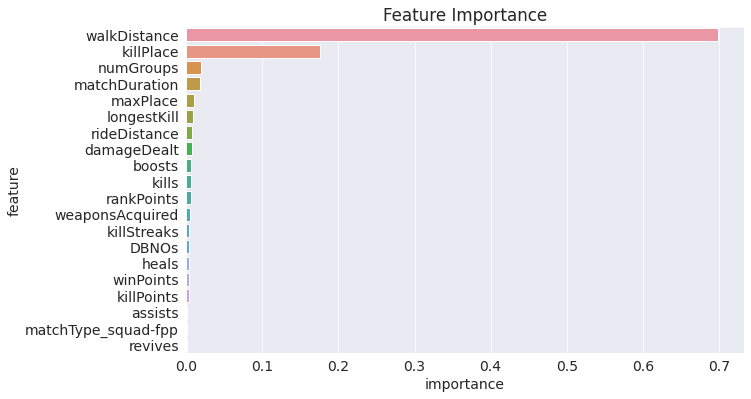

In [ ]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(20), x='importance', y='feature');

## Hyperparameter Tuning with Random Forests

Just like decision trees, random forests also have several hyperparameters. In fact many of these hyperparameters are applied to the underlying decision trees. 

Let's study some the hyperparameters for random forests. You can learn more about them here: https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html


In [ ]:
def Prediction(**params):
 model = RandomForestRegressor(random_state=42, n_jobs=-1, **params).fit(X_train, train_targets)
 return model.score(X_train,train_targets) , model.score(X_val,val_targets)

In [ ]:
Prediction(n_estimators=200)

(0.9882830276453921, 0.9169069301613445)

In [ ]:
d_error()

score without tuning of hyperparameters for -> 
training set:  0.9879932484241635 
validation set:  0.9164190809163845


In [ ]:
def n_estimator_error(n):
    model = RandomForestRegressor(n_estimators=n, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    val_acc = 1 - model.score(X_val, val_targets)
    return {'Number of Estimators': n, 'Training Error': train_acc, 'Validation Error': val_acc}

In [ ]:
errors_df = pd.DataFrame([n_estimator_error(n) for n in [100,200,300,400,500]])

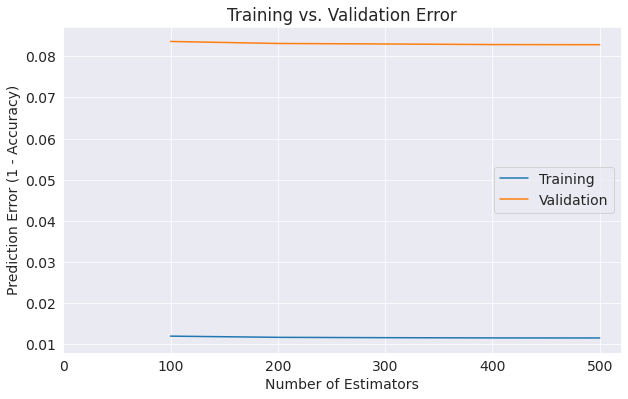

In [ ]:
plt.figure()
plt.plot(errors_df['Number of Estimators'], errors_df['Training Error'])
plt.plot(errors_df['Number of Estimators'], errors_df['Validation Error'])
plt.title('Training vs. Validation Error')
plt.xticks(range(0,600, 100))
plt.xlabel('Number of Estimators')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

In [ ]:
Prediction(max_samples = 40000)

(0.9680352275488043, 0.9163851245523394)

In [ ]:
Prediction(min_samples_split=3,min_samples_leaf=2)

(0.9821466146821412, 0.9165420228856485)

In [ ]:
Prediction(n_estimators=1000,max_samples=40000,min_samples_split=3,min_samples_leaf=2)

(0.96344961478155, 0.9173613735424779)

## Putting it Together and Making Predictions

Let's train a final model on the entire training set with custom hyperparameters. 

In [ ]:
model=RandomForestRegressor(random_state=42, n_jobs=-1,n_estimators=1000,max_samples=40000,min_samples_split=3,min_samples_leaf=2).fit(X_train,train_targets)

In [ ]:
test_preds=model.predict(X_test)

In [ ]:
submission_df

,Id,winPlacePerc
0,9329eb41e215eb,1
1,639bd0dcd7bda8,1
2,63d5c8ef8dfe91,1
3,cf5b81422591d1,1
4,ee6a295187ba21,1
...,...,...
1934169,a316c3a13887d5,1
1934170,5312146b27d875,1
1934171,fc8818b5b32ad3,1
1934172,a0f91e35f8458f,1


In [ ]:
submissionRF_df=submission_df.copy()

In [ ]:
submissionRF_df['winPlacePerc']= test_preds

In [ ]:
submissionRF_df

,Id,winPlacePerc
0,9329eb41e215eb,0.240589
1,639bd0dcd7bda8,0.872385
2,63d5c8ef8dfe91,0.677620
3,cf5b81422591d1,0.562651
4,ee6a295187ba21,0.941781
...,...,...
1934169,a316c3a13887d5,0.731873
1934170,5312146b27d875,0.449221
1934171,fc8818b5b32ad3,0.880693
1934172,a0f91e35f8458f,0.799000


# **2. GRADIENT BOOSTING MODEL**

We're now ready to train our gradient boosting machine (GBM) model. Here's how a GBM model works:

1. The average value of the target column and uses as an initial prediction every input.
2. The residuals (difference) of the predictions with the targets are computed.
3. A decision tree of limited depth is trained to **predict just the residuals** for each input.
4. Predictions from the decision tree are scaled using a parameter called the learning rate (this prevents overfitting)
5. Scaled predictions fro the tree are added to the previous predictions to obtain the new and improved predictions.
6. Steps 2 to 5 are repeated to create new decision trees, each of which is trained to predict just the residuals from the previous prediction.

The term "gradient" refers to the fact that each decision tree is trained with the purpose of reducing the loss from the previous iteration (similar to gradient descent). The term "boosting" refers the general technique of training new models to improve the results of an existing model. 

For a mathematical explanation of gradient boosting, check out the following resources:

- [XGBoost Documentation](https://xgboost.readthedocs.io/en/latest/tutorials/model.html)
- [Video Tutorials on StatQuest](https://www.youtube.com/watch?v=3CC4N4z3GJc&list=PLblh5JKOoLUJjeXUvUE0maghNuY2_5fY6)

Here's a visual representation of gradient boosting:

![](https://miro.medium.com/max/560/1*85QHtH-49U7ozPpmA5cAaw.png)



### Training

To train a GBM, we can use the `XGBRegressor` class from the [`XGBoost`](https://xgboost.readthedocs.io/en/latest/) library.

In [ ]:
from xgboost import XGBRegressor

In [ ]:
model = XGBRegressor(random_state=42, n_jobs=-1, n_estimators=40, max_depth=4)

In [ ]:
model.fit(X_train, train_targets)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=4,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=40, n_jobs=-1, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
preds = model.predict(X_train)

In [ ]:
preds


array([0.92633355, 0.8864101 , 0.60126126, ..., 0.7866503 , 0.32693425,
       0.05322805], dtype=float32)

### Evaluation

Let's evaluate the predictions using RMSE error.

In [ ]:
from sklearn.metrics import mean_squared_error

def rmse(a, b):
    return mean_squared_error(a, b, squared=False)

In [ ]:
rmse(preds, train_targets)

0.08857718780059318

### Visualization

We can visualize individual trees using `plot_tree` (note: this requires the `graphviz` library to be installed).

In [ ]:
!pip install graphviz --upgrade --quiet

In [ ]:
import graphviz
import matplotlib
import matplotlib.pyplot as plt
from xgboost import plot_tree
from matplotlib.pylab import rcParams
%matplotlib inline

import os
os.environ["PATH"] += os.pathsep + 'D:/Program Files (x86)/Graphviz2.38/bin/'

rcParams['figure.figsize'] = 30,30

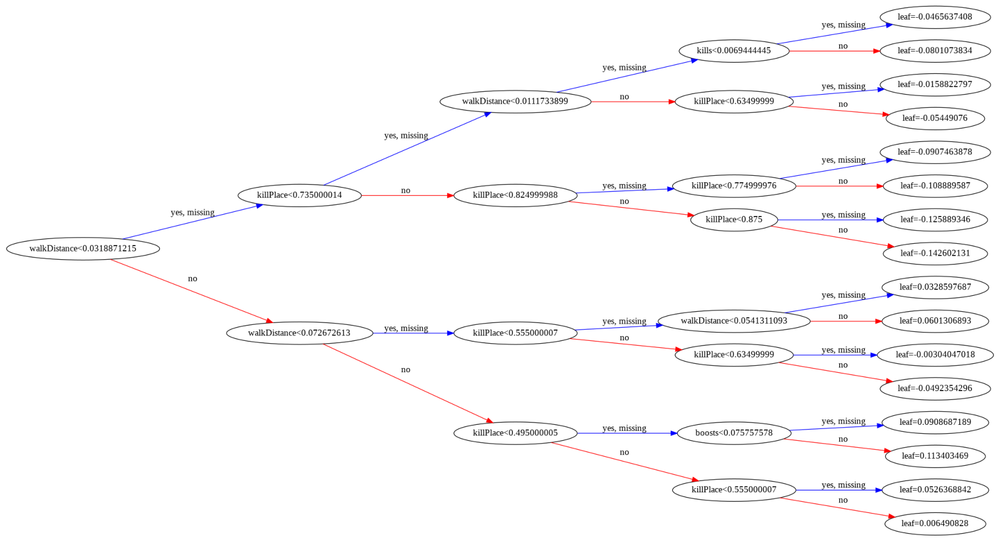

In [ ]:
plot_tree(model, rankdir='LR', num_trees=0);

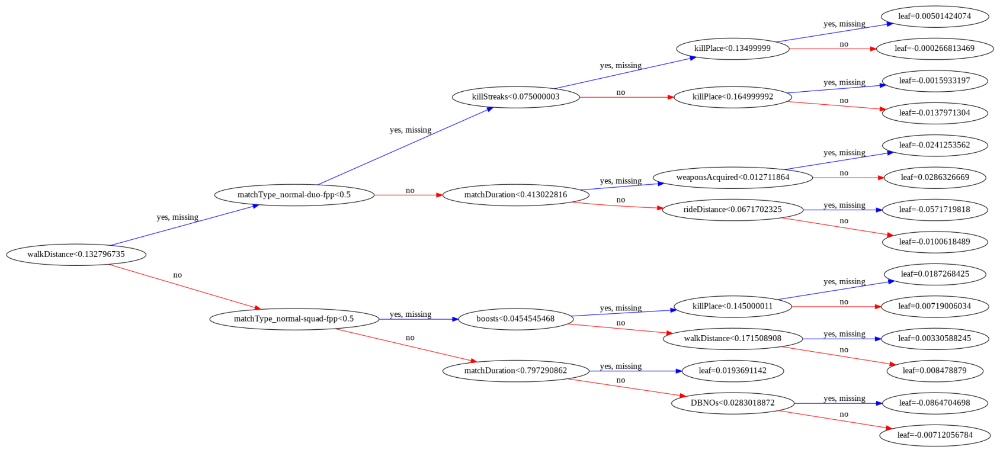

In [ ]:
plot_tree(model, rankdir='LR', num_trees=19);

In [ ]:
trees = model.get_booster().get_dump()

In [ ]:
len(trees)


40

In [ ]:
print(trees[0])

0:[walkDistance<0.0318871215] yes=1,no=2,missing=1
	1:[killPlace<0.735000014] yes=3,no=4,missing=3
		3:[walkDistance<0.0111733899] yes=7,no=8,missing=7
			7:[kills<0.0069444445] yes=15,no=16,missing=15
				15:leaf=-0.0465637408
				16:leaf=-0.0801073834
			8:[killPlace<0.63499999] yes=17,no=18,missing=17
				17:leaf=-0.0158822797
				18:leaf=-0.05449076
		4:[killPlace<0.824999988] yes=9,no=10,missing=9
			9:[killPlace<0.774999976] yes=19,no=20,missing=19
				19:leaf=-0.0907463878
				20:leaf=-0.108889587
			10:[killPlace<0.875] yes=21,no=22,missing=21
				21:leaf=-0.125889346
				22:leaf=-0.142602131
	2:[walkDistance<0.072672613] yes=5,no=6,missing=5
		5:[killPlace<0.555000007] yes=11,no=12,missing=11
			11:[walkDistance<0.0541311093] yes=23,no=24,missing=23
				23:leaf=0.0328597687
				24:leaf=0.0601306893
			12:[killPlace<0.63499999] yes=25,no=26,missing=25
				25:leaf=-0.00304047018
				26:leaf=-0.0492354296
		6:[killPlace<0.495000005] yes=13,no=14,missing=13
			13:[boosts<0.0757575

### Feature importance

Just like decision trees and random forests, XGBoost also provides a feature importance score for each column in the input.

In [ ]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [ ]:
importance_df.head(10)

,feature,importance
21,walkDistance,0.611633
6,killPlace,0.089331
1,boosts,0.054226
3,DBNOs,0.039805
8,kills,0.033005
0,assists,0.015620
12,maxPlace,0.015441
11,matchDuration,0.015332
5,heals,0.015178
13,numGroups,0.014264


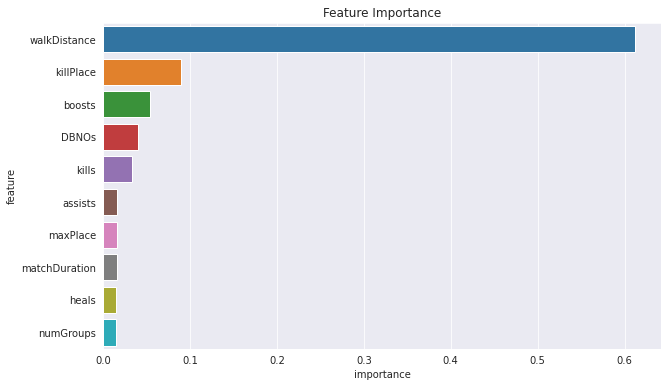

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

## Hyperparameter Tuning and Regularization

Just like other machine learning models, there are several hyperparameters we can to adjust the capacity of model and reduce overfitting.

<img src="https://i.imgur.com/EJCrSZw.png" width="480">

Check out the following resources to learn more about hyperparameter supported by XGBoost:

- https://xgboost.readthedocs.io/en/latest/python/python_api.html#xgboost.XGBRegressor
- https://xgboost.readthedocs.io/en/latest/parameter.html

In [ ]:
def test_params(**params):
    model = XGBRegressor(n_jobs=-1, random_state=42, **params)
    model.fit(X_train, train_targets)
    train_rmse = rmse(model.predict(X_train), train_targets)
    val_rmse = rmse(model.predict(X_val), val_targets)
    print('Train RMSE: {}, Validation RMSE: {}'.format(train_rmse, val_rmse))

In [ ]:
test_params(n_estimators=10)

Train RMSE: 0.09313560594250833, Validation RMSE: 0.0940960494666432


In [ ]:
test_params(n_estimators=1000)

Train RMSE: 0.04263349563198323, Validation RMSE: 0.08586416170192253


In [ ]:
test_params(max_depth=2)

Train RMSE: 0.09649538600124413, Validation RMSE: 0.0956681103037899


In [ ]:
test_params(max_depth=5)

Train RMSE: 0.07732631753529119, Validation RMSE: 0.08327855357216857


In [ ]:
test_params(max_depth=10)

Train RMSE: 0.0466993173219102, Validation RMSE: 0.08568213964461499


In [ ]:
test_params(n_estimators=800, learning_rate=0.01)

Train RMSE: 0.08211833631439114, Validation RMSE: 0.08545515909557087


In [ ]:
test_params(n_estimators=800, learning_rate=0.1)

Train RMSE: 0.06404407770223292, Validation RMSE: 0.08149577932457176


In [ ]:
test_params(n_estimators=800, learning_rate=0.3)

Train RMSE: 0.046994118230627206, Validation RMSE: 0.08540284496194711


In [ ]:
test_params(n_estimators=50, learning_rate=0.3)

Train RMSE: 0.07786678097023413, Validation RMSE: 0.08453342728821583


In [ ]:
test_params(n_estimators=50, learning_rate=0.8)

Train RMSE: 0.07510822948031531, Validation RMSE: 0.08961113783786262


In [ ]:
test_params(booster='gblinear')

Train RMSE: 0.1254729138680193, Validation RMSE: 0.12498222623186264


## Putting it Together and Making Predictions

Let's train a final model on the entire training set with custom hyperparameters. 

In [ ]:
model = XGBRegressor(n_jobs=-1, random_state=42, n_estimators=1000, 
                     learning_rate=0.3, max_depth=5, subsample=0.9, 
                     colsample_bytree=0.7)

In [ ]:
%%time
model.fit(X_train, train_targets)

CPU times: user 3min 9s, sys: 296 ms, total: 3min 9s
Wall time: 1min 36s


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.7, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.3, max_delta_step=0, max_depth=5,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=1000, n_jobs=-1, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.9,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
test_preds1 = model.predict(X_test)

In [ ]:
test_preds1

array([0.2770299 , 0.9924678 , 0.6727648 , ..., 0.8750714 , 0.81907046,
       0.07314704], dtype=float32)

In [ ]:
submissionGR_df = pd.DataFrame({
    'Id':submission_df.Id,
    'winPlacePerc':test_preds1
})

In [ ]:
submissionGR_df

,Id,winPlacePerc
0,9329eb41e215eb,0.277030
1,639bd0dcd7bda8,0.992468
2,63d5c8ef8dfe91,0.672765
3,cf5b81422591d1,0.539717
4,ee6a295187ba21,0.965573
...,...,...
1934169,a316c3a13887d5,0.729950
1934170,5312146b27d875,0.453271
1934171,fc8818b5b32ad3,0.875071
1934172,a0f91e35f8458f,0.819070


## Summary and References

The following topics were covered in this notebook:

- Downloading a real-world dataset
- Preparing a dataset for training
- Training and interpreting random forests
- Training and interpreting gradient boosting machine
- Overfitting, hyperparameter tuning & regularization


References: 

- https://scikit-learn.org/stable/modules/tree.html
- https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
- https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction
- https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering
- https://www.kaggle.com/willkoehrsen/intro-to-model-tuning-grid-and-random-search
- https://www.kaggle.com/c/home-credit-default-risk/discussion/64821
- https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html